# 00 MAIN

## Notebook setup

In [1]:
import scanpy as sc
import scanpy.external as sce
import numpy as np
import pandas as pd
import warnings, scipy.sparse as sp, matplotlib, matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.pyplot import rc_context
from collections import Counter
import matplotlib.font_manager
import openpyxl
import pyreadr
import rpy2
from rpy2.robjects.packages import importr
import rpy2.robjects as robjects
#import magic
#import seaborn as sns
import palantir
import loompy
import feather
import re
#from scipy.sparse import csgraph

matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
matplotlib.rcParams['font.family'] = 'sans-serif'
matplotlib.rcParams['font.sans-serif'] = 'Arial'
matplotlib.rc('font', size=14)
import matplotlib.lines as lines

pd.set_option('display.max_rows', 200)

sc.set_figure_params(dpi=80, dpi_save=300, color_map='Spectral_r', vector_friendly=True, transparent=True)
sc.settings.verbosity = 3 # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()

warnings.filterwarnings('ignore', category=UserWarning)
warnings.filterwarnings('ignore', category=FutureWarning)

findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
/Users/akousa/opt/anaconda3/envs/KousaJahnZhao_et_al_2023/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.20.2 scipy==1.5.3 pandas==1.4.4 scikit-learn==1.1.2 statsmodels==0.13.2 python-igraph==0.9.11 pynndescent==0.5.7


In [2]:
user_defined_palette =  [ '#F6222E', '#FEAF16','#3283FE','#BDCDFF', '#3B00FB', '#F8A19F', '#1CFFCE',  '#C4451C', 
                          '#2ED9FF', '#c1c119', '#8b0000', '#FE00FA', '#1CBE4F','#B5EFB5', '#0e452b', '#AA0DFE']

In [3]:
user_defined_cmap_markers = LinearSegmentedColormap.from_list('mycmap', ["#E6E6FF", "#CCCCFF", "#B2B2FF", "#9999FF",  "#6666FF",   "#3333FF", "#0000FF"])
user_defined_cmap_degs = LinearSegmentedColormap.from_list('mycmap', ["#0000FF", "#3333FF", "#6666FF", "#9999FF", "#B2B2FF", "#CCCCFF", "#E6E6FF", "#E6FFE6", "#CCFFCC", "#B2FFB2", "#99FF99", "#66FF66", "#33FF33", "#00FF00"])

In [4]:
%matplotlib inline 

## Load data for Figure 1

In [5]:
path_to_h5ad = '../output/anndata_io/Fig1pt1.h5ad'

In [6]:
adata_d0 = sc.read_h5ad(path_to_h5ad)
adata_d0.uns['log1p']["base"] = None

In [7]:
adata_d0.shape

(22932, 27657)

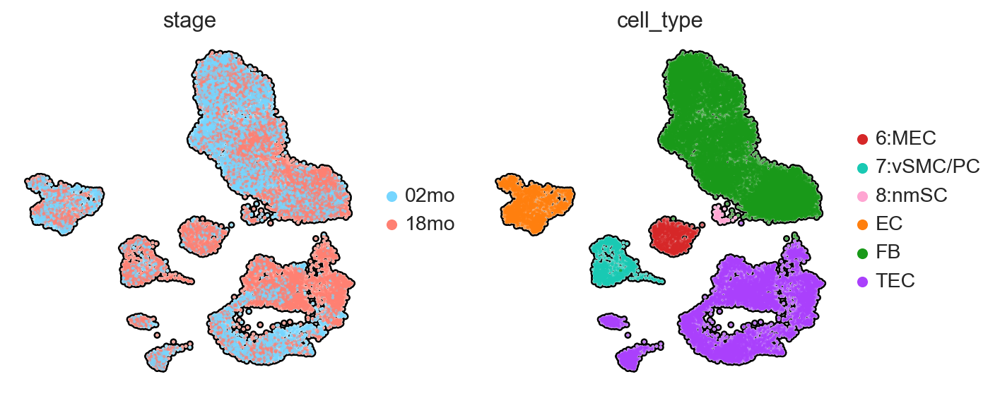

In [8]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='Spectral_r', vector_friendly=True, transparent=True)

sc.pl.umap(adata_d0, color=['stage', 'cell_type'], 
                     color_map='Spectral_r',
                     use_raw=False, 
                     ncols=4, 
                     wspace = 0.2,
                     outline_width=[0.6, 0.05], 
                     size=15,  
                     frameon=False, 
                     add_outline=True, 
                     sort_order = False
          )

## Analyze TEC, FB and EC and annotate based on public marker genes and signatures

### Our ECs

In [9]:
EC_d0 = adata_d0[(adata_d0.obs['cell_type']=='EC')]

In [10]:
# Remove columns with all 0s
sc.pp.filter_genes(EC_d0, min_cells=1)

filtered out 9288 genes that are detected in less than 1 cells


In [11]:
EC_d0.shape

(1661, 18369)

In [12]:
sc.pp.highly_variable_genes(EC_d0, n_top_genes=3500, n_bins=20, flavor='seurat')

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [13]:
rng = np.random.RandomState(42)
sc.tl.pca(EC_d0, n_comps=200, svd_solver='arpack', random_state=rng, use_highly_variable=True)

computing PCA
    on highly variable genes
    with n_comps=200
    finished (0:00:00)


<function matplotlib.pyplot.show(close=None, block=None)>

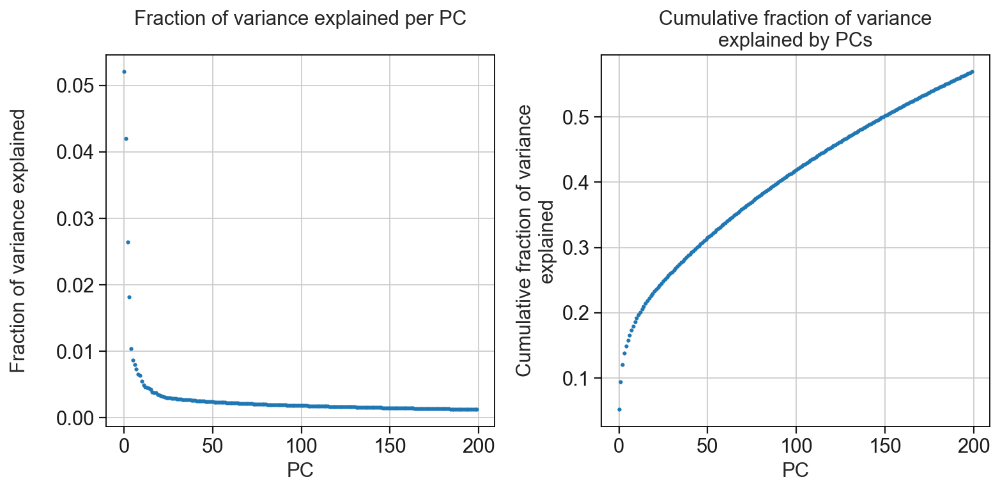

In [14]:
def observe_variance(anndata_object):
    fig = plt.figure(figsize=(10,5))
    ax1 = fig.add_subplot(121)
    ax2 = fig.add_subplot(122)
    # variance per principal component
    x = range(len(anndata_object.uns['pca']['variance_ratio']))
    y = anndata_object.uns['pca']['variance_ratio']
    ax1.scatter(x,y,s=4)
    ax1.set_xlabel('PC')
    ax1.set_ylabel('Fraction of variance explained\n')
    ax1.set_title('Fraction of variance explained per PC\n')
    # cumulative variance explained
    cml_var_explained = np.cumsum(anndata_object.uns['pca']['variance_ratio'])
    x = range(len(anndata_object.uns['pca']['variance_ratio']))
    y = cml_var_explained
    ax2.scatter(x,y,s=4)
    ax2.set_xlabel('PC')
    ax2.set_ylabel('Cumulative fraction of variance\nexplained')
    ax2.set_title('Cumulative fraction of variance\nexplained by PCs')
    fig.tight_layout()
    plot = plt.show
    return(plot)
observe_variance(EC_d0)

In [15]:
rng = np.random.RandomState(42)
sc.tl.pca(EC_d0, n_comps=30, svd_solver='arpack', random_state=rng, use_highly_variable=True)

computing PCA
    on highly variable genes
    with n_comps=30
    finished (0:00:00)


In [16]:
sce.pp.harmony_integrate(EC_d0, 'sample')

2024-04-08 15:33:13,189 - harmonypy - INFO - Iteration 1 of 10
2024-04-08 15:33:13,366 - harmonypy - INFO - Iteration 2 of 10
2024-04-08 15:33:13,509 - harmonypy - INFO - Iteration 3 of 10
2024-04-08 15:33:13,649 - harmonypy - INFO - Iteration 4 of 10
2024-04-08 15:33:13,739 - harmonypy - INFO - Iteration 5 of 10
2024-04-08 15:33:13,828 - harmonypy - INFO - Iteration 6 of 10
2024-04-08 15:33:13,914 - harmonypy - INFO - Iteration 7 of 10
2024-04-08 15:33:13,995 - harmonypy - INFO - Iteration 8 of 10
2024-04-08 15:33:14,094 - harmonypy - INFO - Iteration 9 of 10
2024-04-08 15:33:14,154 - harmonypy - INFO - Iteration 10 of 10
2024-04-08 15:33:14,219 - harmonypy - INFO - Stopped before convergence


In [17]:
sc.pp.neighbors(EC_d0, n_neighbors=15, use_rep='X_pca_harmony')
sc.tl.umap(EC_d0)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:02)


### ECs in other tissues

In [18]:
arteries = ['8430408g22Rik', 'Clu', 'Crip1', 'Fbln2', 'Gja4',  'Hey1', 'Mecom', 'Sat1', 'Sema3g', 'Sox17', 'Tm4sf1', 'Tsc22d1'] 
capilaries = ['Aw112010', 'Bc028528', 'Car4', 'Cd200', 'Cd300lg',  'Gpihbp1', 'Kdr',  'Rgcc',  'Sgk1', 'Sparc']
veins = ['Apoe', 'Bgn', 'Ctla2a', 'Icam1', 'Il6st',  'Ptgs1',  'Tmsb10', 'Vcam1',  'Vwf']
lymphatic = ['Prox1', 'Pdpn', 'Lyve1']

In [19]:
sc.tl.score_genes(EC_d0, gene_list = arteries,  score_name='arterial', use_raw=False)
sc.tl.score_genes(EC_d0, gene_list = capilaries,  score_name='capilary', use_raw=False)
sc.tl.score_genes(EC_d0, gene_list = veins,  score_name='venular', use_raw=False)
sc.tl.score_genes(EC_d0, gene_list = lymphatic,  score_name='lymphatic', use_raw=False)

computing score 'arterial'
    finished: added
    'arterial', score of gene set (adata.obs).
    150 total control genes are used. (0:00:00)
computing score 'capilary'
    finished: added
    'capilary', score of gene set (adata.obs).
    50 total control genes are used. (0:00:00)
computing score 'venular'
    finished: added
    'venular', score of gene set (adata.obs).
    199 total control genes are used. (0:00:00)
computing score 'lymphatic'
    finished: added
    'lymphatic', score of gene set (adata.obs).
    99 total control genes are used. (0:00:00)


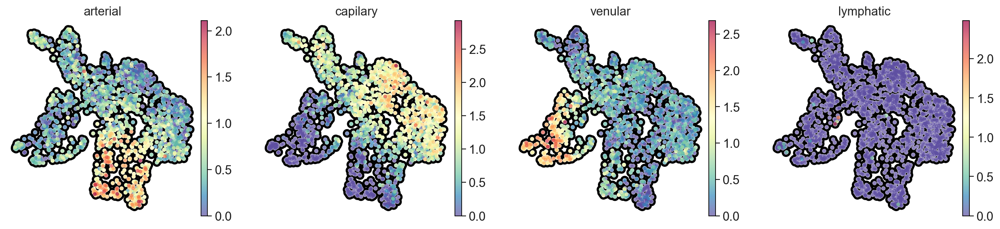

In [20]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='Spectral_r', vector_friendly=True, transparent=True)

sc.pl.umap(
    EC_d0,
    color=['arterial', 'capilary','venular', 'lymphatic'],
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.2,
    outline_width=[0.6, 0.05],
    frameon=False,
    add_outline=True,
    sort_order = True,
    vmin=0
)

### ECs clustering and annotation

In [21]:
for resolution_parameter in [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]:
    sc.tl.leiden(EC_d0, resolution=resolution_parameter, random_state=42, 
                        key_added='leiden_'+str(resolution_parameter))

running Leiden clustering
    finished: found 5 clusters and added
    'leiden_0.1', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 5 clusters and added
    'leiden_0.2', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 6 clusters and added
    'leiden_0.3', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 8 clusters and added
    'leiden_0.4', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 9 clusters and added
    'leiden_0.5', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 9 clusters and added
    'leiden_0.6', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 10 clusters and added
    'leiden_0.7', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering


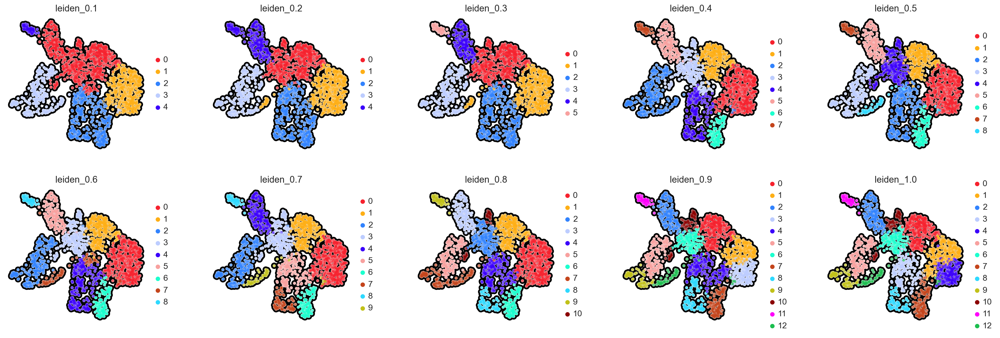

In [22]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)
sc.pl.umap(
    EC_d0, 
    color=['leiden_0.1', 'leiden_0.2', 'leiden_0.3', 'leiden_0.4', 'leiden_0.5', 
           'leiden_0.6', 'leiden_0.7', 'leiden_0.8','leiden_0.9', 'leiden_1.0'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.3,
    outline_width=[0.6, 0.05],
    frameon=False,
    add_outline=True,
    sort_order = False
)

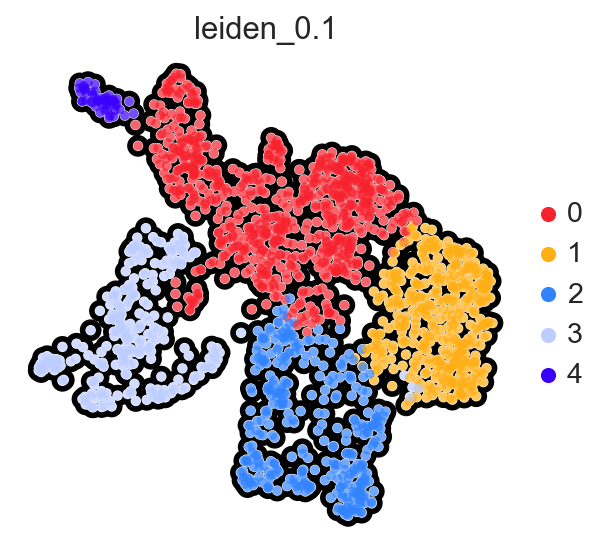

In [23]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)
sc.pl.umap(
    EC_d0, 
    color=['leiden_0.1'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.7,
    outline_width=[0.6, 0.05],
    frameon=False,
    add_outline=True,
    sort_order = False
)

In [24]:
EC_d0.obs['cell_type_subset'] = ['0:arEC' if (x=='2') else 
                                 '1:capEC' if (x=='0' or x=='1' or x=='4') else
                                 '2:venEC' if (x=='3') else 'ERROR' for x in EC_d0.obs['leiden_0.1']] 

In [25]:
EC_d0.uns['cell_type_subset_colors'] = ['#F6222E', '#3283FE', '#16FF32']

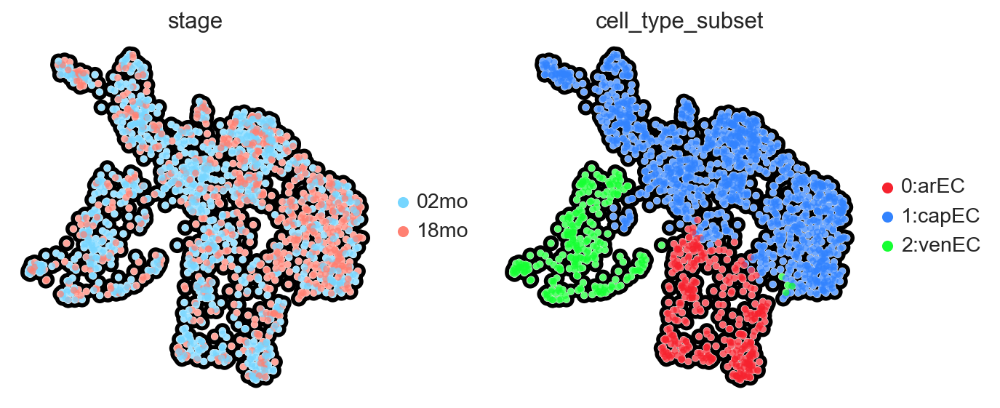

In [26]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    EC_d0, 
    color=['stage', 'cell_type_subset'], 
    ncols=6,
    outline_width=[0.6, 0.05],
    frameon=False,
    cmap='Spectral_r',
    wspace = 0.2,
    use_raw=False,
    add_outline=True
)

### DGE analysis within the EC compartment

In [ ]:
sc.tl.rank_genes_groups(EC_d0, 'cell_type_subset', method='wilcoxon', use_raw=False)

In [ ]:
writer = pd.ExcelWriter('EC_d0_wilcox.xlsx', engine='xlsxwriter')

# top 5 differentially expressed genes for each cell type. Change number in brackets to get a more extended gene list
result = EC_d0.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'scores', 'logfoldchanges', 'pvals_adj']}).to_excel(writer)

writer.save()

### Our FB

In [27]:
FB_d0 = adata_d0[(adata_d0.obs['cell_type']=='FB')]

In [28]:
# Remove columns with all 0s
sc.pp.filter_genes(FB_d0, min_cells=1)

filtered out 4524 genes that are detected in less than 1 cells


In [29]:
FB_d0.shape

(13240, 23133)

In [30]:
sc.pp.highly_variable_genes(FB_d0, n_top_genes=3500, n_bins=20, flavor='seurat')

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [31]:
rng = np.random.RandomState(42)
sc.tl.pca(FB_d0, n_comps=200, svd_solver='arpack', random_state=rng, use_highly_variable=True)

computing PCA
    on highly variable genes
    with n_comps=200
    finished (0:00:03)


<function matplotlib.pyplot.show(close=None, block=None)>

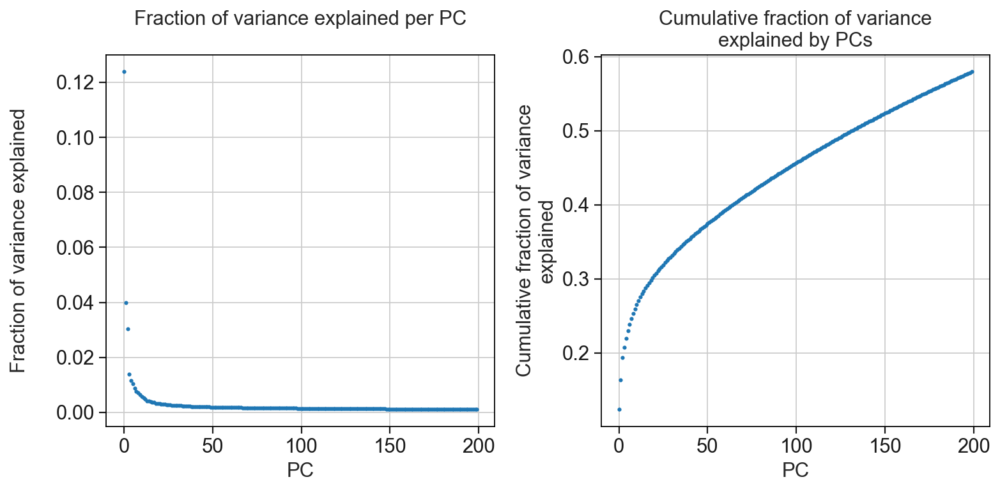

In [32]:
observe_variance(FB_d0)

In [33]:
rng = np.random.RandomState(42)
sc.tl.pca(FB_d0, n_comps=50, svd_solver='arpack', random_state=rng, use_highly_variable=True)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)


In [34]:
sce.pp.harmony_integrate(FB_d0, 'sample')

2024-04-08 15:34:13,847 - harmonypy - INFO - Iteration 1 of 10
2024-04-08 15:34:15,649 - harmonypy - INFO - Iteration 2 of 10
2024-04-08 15:34:17,398 - harmonypy - INFO - Iteration 3 of 10
2024-04-08 15:34:19,139 - harmonypy - INFO - Iteration 4 of 10
2024-04-08 15:34:20,906 - harmonypy - INFO - Iteration 5 of 10
2024-04-08 15:34:22,793 - harmonypy - INFO - Iteration 6 of 10
2024-04-08 15:34:24,512 - harmonypy - INFO - Iteration 7 of 10
2024-04-08 15:34:25,453 - harmonypy - INFO - Converged after 7 iterations


In [35]:
sc.pp.neighbors(FB_d0, n_neighbors=15, use_rep='X_pca_harmony')
sc.tl.umap(FB_d0)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:18)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:09)


In [36]:
for resolution_parameter in [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]:
    sc.tl.leiden(FB_d0, resolution=resolution_parameter, random_state=42, 
                        key_added='leiden_'+str(resolution_parameter))

running Leiden clustering
    finished: found 3 clusters and added
    'leiden_0.1', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 4 clusters and added
    'leiden_0.2', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 4 clusters and added
    'leiden_0.3', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 4 clusters and added
    'leiden_0.4', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 6 clusters and added
    'leiden_0.5', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 7 clusters and added
    'leiden_0.6', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 10 clusters and added
    'leiden_0.7', the cluster labels (adata.obs, categorical) (0:00:01)
running Leiden clustering


In [ ]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)
sc.pl.umap(
    FB_d0, 
    color=['leiden_0.1', 'leiden_0.2', 'leiden_0.3', 'leiden_0.4', 'leiden_0.5', 
           'leiden_0.6', 'leiden_0.7', 'leiden_0.8','leiden_0.9', 'leiden_1.0'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    size=15,
    wspace = 0.3,
    outline_width=[0.6, 0.05],
    frameon=False,
    add_outline=True,
    sort_order = False
)

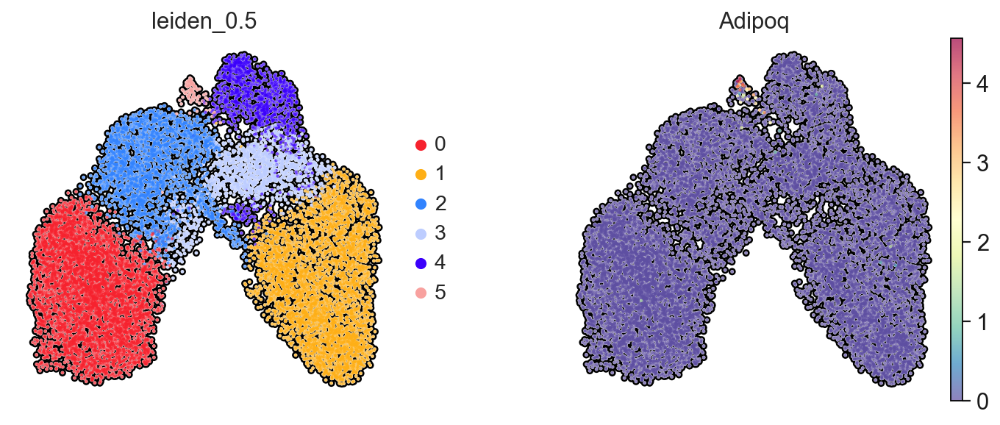

In [38]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    FB_d0, 
    color=['leiden_0.5', 'Adipoq'], 
    ncols=6,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    cmap='Spectral_r',
    wspace = 0.3,
    add_outline=True,
    use_raw=False
)

In [39]:
FB_d0.obs['cell_type_subset'] = ['3:capsFB' if (x=='1') else 
                                 '4:intFB' if (x=='2' or x=='3' or x=='4') else
                                 '5:medFB' if (x=='0') else
                                 '9:Fat' if (x=='5') else 'ERROR' for x in FB_d0.obs['leiden_0.5']] 

In [40]:
FB_d0.uns['cell_type_subset_colors'] = ['#BDCDFF', '#AA0DFE', '#1CFFCE', 'grey']

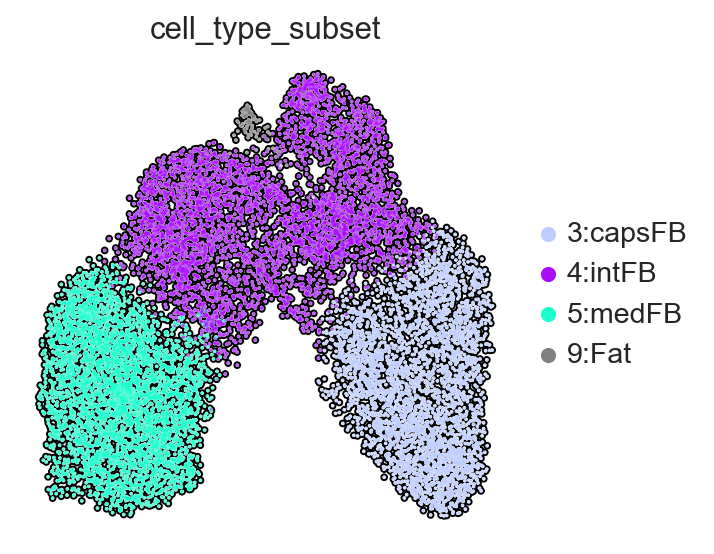

In [41]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    FB_d0, 
    color=['cell_type_subset'], 
    ncols=6,
    outline_width=[0.6, 0.05],
    frameon=False,
    cmap='Spectral_r',
    wspace = 0.3,
    add_outline=True
)

In [42]:
FB_d0_nofat = FB_d0[(FB_d0.obs['cell_type_subset']!='9:Fat')]

In [43]:
# Remove columns with all 0s
sc.pp.filter_genes(FB_d0_nofat, min_cells=1)

filtered out 35 genes that are detected in less than 1 cells


In [44]:
sc.pp.highly_variable_genes(FB_d0_nofat, n_top_genes=3500, n_bins=20, flavor='seurat')

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [45]:
rng = np.random.RandomState(42)
sc.tl.pca(FB_d0_nofat, n_comps=200, svd_solver='arpack', random_state=rng, use_highly_variable=True)

computing PCA
    on highly variable genes
    with n_comps=200
    finished (0:00:03)


<function matplotlib.pyplot.show(close=None, block=None)>

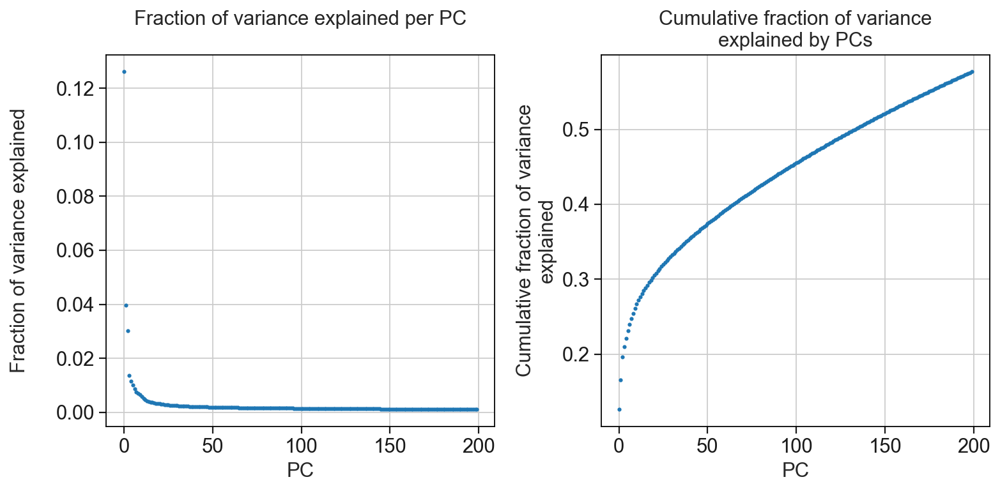

In [46]:
observe_variance(FB_d0_nofat)

In [47]:
rng = np.random.RandomState(42)
sc.tl.pca(FB_d0_nofat, n_comps=45, svd_solver='arpack', random_state=rng, use_highly_variable=True)

computing PCA
    on highly variable genes
    with n_comps=45
    finished (0:00:00)


In [48]:
sce.pp.harmony_integrate(FB_d0_nofat, 'sample')

2024-04-08 15:35:14,696 - harmonypy - INFO - Iteration 1 of 10
2024-04-08 15:35:16,465 - harmonypy - INFO - Iteration 2 of 10
2024-04-08 15:35:18,177 - harmonypy - INFO - Iteration 3 of 10
2024-04-08 15:35:19,885 - harmonypy - INFO - Iteration 4 of 10
2024-04-08 15:35:21,598 - harmonypy - INFO - Iteration 5 of 10
2024-04-08 15:35:22,843 - harmonypy - INFO - Iteration 6 of 10
2024-04-08 15:35:23,985 - harmonypy - INFO - Iteration 7 of 10
2024-04-08 15:35:24,970 - harmonypy - INFO - Converged after 7 iterations


In [49]:
sc.pp.neighbors(FB_d0_nofat, n_neighbors=15, use_rep='X_pca_harmony')
sc.tl.umap(FB_d0_nofat)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:09)


In [50]:
capsular = ['Akr1c18',	'Mrgprg',	'Upk3b',	'Smpd3',	'Sema3c',	'Dpp4',	'Efhd1',	'Pcsk6',	'Pi16',	'Ackr3',	'Sfrp2',	'Msln',	'Sfrp4',	'Adgrd1',	'Spon2',	'Mfap5',	'Gpc3',	'Saa3',	'Ogn',	'Mt2',	'Cpxm2',	'Lrrn4cl',	'Fndc1',	'Anxa3',	'Qpct',	'Cxcl13',	'Smoc2',	'Igfbp6',	'Nov',	'Csrp2']
medullary = ['Gja4',	'Mmp9',	'Pde2a',	'Vtn',	'Des',	'Crsc',	'Ecscr',	'C1qtnf5',	'Cx3cl1',	'Acta2',	'Meox1',	'Sdc3',	'Postn',	'Tagln',	'Serpine2',	'Enpp2',	'SlcO2b1',	'Ndufa4l2',	'Serpina3g',	'Ltbp1',	'Gfra2',	'Mfge8',	'Rasa3']
perilobular = ['C7',	'Dpt',	'Ptn',	'Ptgds',	'Rbp5',	'Rspo3',	'Mfap4',	'Sparcl1',	'Srpx',	'Hspb6',	'Ccl2',	'Fxyd6',	'Nr2f1',	'Dbi',	'Spry1',	'Litaf',	'Dcn',	'Runx1t1',	'Rwdd1']
interlobular = ['Lum',	'Mgp',	'Ogn',	'Fn1',	'Igfbp6',	'Col1a2',	'Col14a1',	'Col3a1',	'Col1a1',	'Fbn1',	'Dcn',	'Itm2a',	'Ccdc80',	'Ctsk',	'Wisp2',	'Id2',	'Spon2',	'Fstl1',	'Fbln2',	'Mfap5']

In [51]:
sc.tl.score_genes(FB_d0_nofat, gene_list = perilobular,  score_name='perilobular\n(human)', use_raw=False)
sc.tl.score_genes(FB_d0_nofat, gene_list = interlobular,  score_name='interlobular\n(human)', use_raw=False)
sc.tl.score_genes(FB_d0_nofat, gene_list = capsular,  score_name='capsular\n(mouse)', use_raw=False)
sc.tl.score_genes(FB_d0_nofat, gene_list = medullary,  score_name='medullary\n(mouse)', use_raw=False)

computing score 'perilobular\n(human)'
    finished: added
    'perilobular\n(human)', score of gene set (adata.obs).
    409 total control genes are used. (0:00:00)
computing score 'interlobular\n(human)'
    finished: added
    'interlobular\n(human)', score of gene set (adata.obs).
    160 total control genes are used. (0:00:00)
computing score 'capsular\n(mouse)'
    finished: added
    'capsular\n(mouse)', score of gene set (adata.obs).
    450 total control genes are used. (0:00:00)
computing score 'medullary\n(mouse)'
    finished: added
    'medullary\n(mouse)', score of gene set (adata.obs).
    549 total control genes are used. (0:00:00)


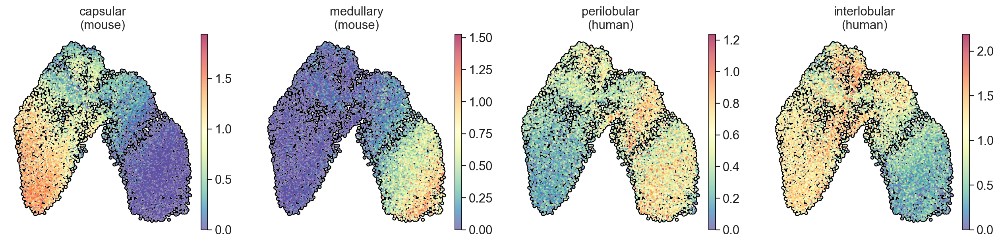

In [52]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    FB_d0_nofat,
    color=['capsular\n(mouse)', 'medullary\n(mouse)', 'perilobular\n(human)', 'interlobular\n(human)'],
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.2,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = True,
    vmin=0
)

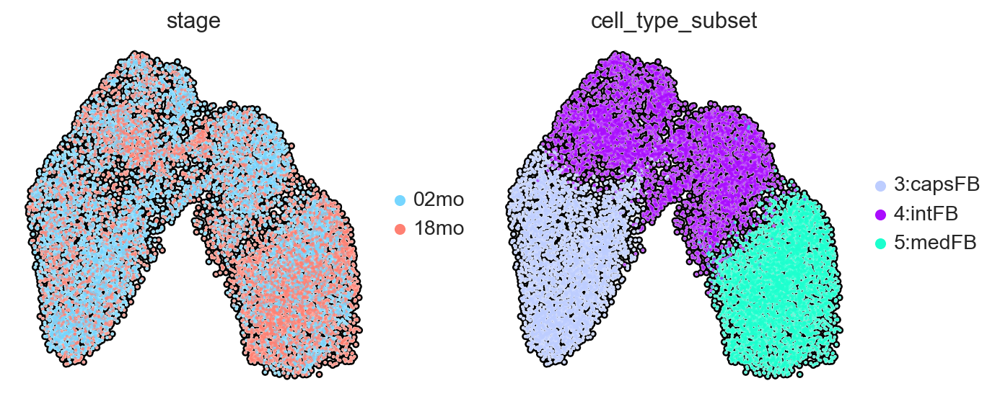

In [53]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    FB_d0_nofat, 
    color=['stage', 'cell_type_subset'], 
    ncols=6,
    use_raw=False,
    outline_width=[0.6, 0.05],
    frameon=False,
    size=15,
    cmap='Spectral_r',
    wspace = 0.2,
    add_outline=True
)

### DGE analysis within the FB compartment

In [ ]:
sc.tl.rank_genes_groups(FB_d0_nofat, 'cell_type_subset', method='wilcoxon', use_raw=False)

In [ ]:
writer = pd.ExcelWriter('FB_d0_wilcox.xlsx', engine='xlsxwriter')

# top 5 differentially expressed genes for each cell type. Change number in brackets to get a more extended gene list
result = FB_d0_nofat.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'scores', 'logfoldchanges', 'pvals_adj']}).to_excel(writer)

writer.save()

### TEC

In [54]:
TEC_d0 = adata_d0[(adata_d0.obs['cell_type']=='TEC')]

In [55]:
# Remove columns with all 0s
sc.pp.filter_genes(TEC_d0, min_cells=1)

filtered out 651 genes that are detected in less than 1 cells


In [56]:
sc.pp.highly_variable_genes(TEC_d0, n_top_genes=3500, n_bins=20, flavor='seurat')

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [57]:
rng = np.random.RandomState(42)
sc.tl.pca(TEC_d0, n_comps=200, svd_solver='arpack', random_state=rng, use_highly_variable=True)

computing PCA
    on highly variable genes
    with n_comps=200
    finished (0:00:01)


<function matplotlib.pyplot.show(close=None, block=None)>

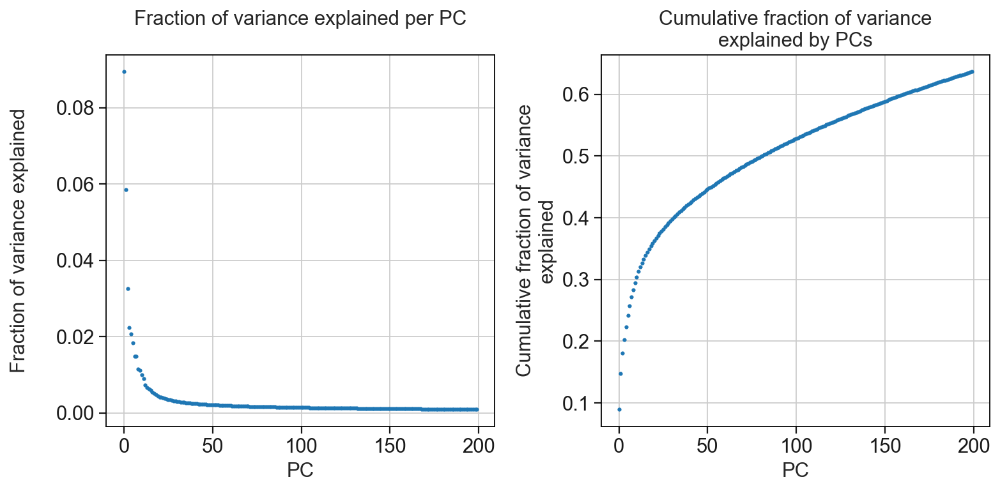

In [58]:
observe_variance(TEC_d0)

In [59]:
rng = np.random.RandomState(42)
sc.tl.pca(TEC_d0, n_comps=50, svd_solver='arpack', random_state=rng, use_highly_variable=True)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


In [60]:
sce.pp.harmony_integrate(TEC_d0, 'sample')

2024-04-08 15:35:48,860 - harmonypy - INFO - Iteration 1 of 10
2024-04-08 15:35:49,675 - harmonypy - INFO - Iteration 2 of 10
2024-04-08 15:35:50,476 - harmonypy - INFO - Iteration 3 of 10
2024-04-08 15:35:51,244 - harmonypy - INFO - Iteration 4 of 10
2024-04-08 15:35:51,817 - harmonypy - INFO - Converged after 4 iterations


In [61]:
sc.pp.neighbors(TEC_d0, n_neighbors=15, use_rep='X_pca_harmony')
sc.tl.umap(TEC_d0)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:09)


###  Bornstein et al.

In [62]:
cTEC = ['Ccl25', 'Psmb11','Ly75','Prss16', 'Ctsl','Pax1']
mTEC1 = ['Itga6', 'Itgb4', 'Sox4', 'Ly6a', 'Ccl21a', 'Krt5', 'Ascl1', 'Ccl21c', 'Apoe']
mTEC2 = ['Aire', 'Fezf2', 'Cd40', 'H2-Aa', 'H2-Ab1', 'Cd74', 'Hdc', 'Ubd', 'Cd52']
mTEC3a = ['Spink5', 'Ly6d']
mTEC3b = ['Pigr', 'Car8']
mTEC3c = ['Ccl20', 'Serpinb6a']
mTEC4 =  ['Lrmp', 'Avil', 'Trpm5', 'Dclk1', 'Gng13', 'Ptgs1', 'L1cam', 'Sox9', 'Il25', 'Pou2f3', 'Gp2', 'Gnb3', 'Ptgs1', 'Il17rb']

In [63]:
sc.tl.score_genes(TEC_d0, gene_list = cTEC,  score_name='cTEC', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = mTEC1,  score_name='mTEC1', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = mTEC2,  score_name='mTEC2', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = mTEC3a,  score_name='mTEC3(a)', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = mTEC3b,  score_name='mTEC3(b)', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = mTEC3c,  score_name='mTEC3(c)', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = mTEC4,  score_name='mTEC4', use_raw=False)

computing score 'cTEC'
    finished: added
    'cTEC', score of gene set (adata.obs).
    250 total control genes are used. (0:00:00)
computing score 'mTEC1'
    finished: added
    'mTEC1', score of gene set (adata.obs).
    199 total control genes are used. (0:00:00)
computing score 'mTEC2'
    finished: added
    'mTEC2', score of gene set (adata.obs).
    156 total control genes are used. (0:00:00)
computing score 'mTEC3(a)'
    finished: added
    'mTEC3(a)', score of gene set (adata.obs).
    100 total control genes are used. (0:00:00)
computing score 'mTEC3(b)'
    finished: added
    'mTEC3(b)', score of gene set (adata.obs).
    100 total control genes are used. (0:00:00)
computing score 'mTEC3(c)'
    finished: added
    'mTEC3(c)', score of gene set (adata.obs).
    100 total control genes are used. (0:00:00)
computing score 'mTEC4'
    finished: added
    'mTEC4', score of gene set (adata.obs).
    499 total control genes are used. (0:00:00)


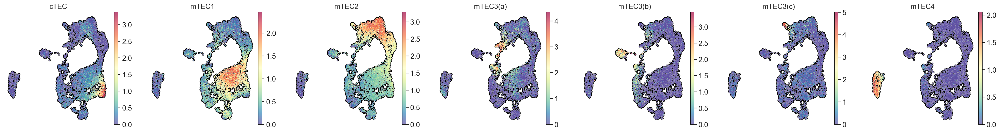

In [64]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    TEC_d0,
    color=['cTEC', 'mTEC1', 'mTEC2', 'mTEC3(a)', 'mTEC3(b)', 'mTEC3(c)','mTEC4'],
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=9,
    wspace = 0.2,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = True,
    vmin=0
)

### Dhalla et al.

In [65]:
preAire1 = ['Krt5',	'Ifi27l2a',	'Ccl21a',	'Krt14',	'Ifitm3',	'Apoe',	'Bst2',	'Ifitm2',	'Isg15',	'Ly6a']
preAire2 = ['Ccl21a',	'Ctsl',	'Ifitm3',	'Ifi27l2a',	'Tpm2',	'Tmsb10',	'Krt5',	'Mdk',	'Krt7',	'Krt17']
proliferating = ['Eif5a',	'Ran',	'Ppia',	'Npm1',	'H2afz',	'Eif4a1',	'Stmn1',	'Phgdh',	'Rps2',	'Utf1']
mature1 = ['Rplp0',	'Hdc',	'Aire',	'H2-dmb2',	'Hagh',	'Calcb',	'S100a14',	'Lrrc42',	'Cd74',	'Srgn']
mature2 = ['Ubd',	'Csn2',	'Malat1',	'H2-Eb1']
mature3 = ['Cd52',	'Npc2',	'H2-Oa',	'H2-Ab1',	'Ubd',	'H2-Aa',	'H2-Eb1',	'Atp6v0e',	'Srgn',	'Alas1']
postAire1 = ['Aw112010',	'Lypd8',	'Cldn7',	'Prap1',	'Spink1',	'Ahcyl2',	'2200002D01Rik',	'Gpx1',	'2210407c18Rik',	'Lgals4']
postAire2 = ['Ly6d',	'Fxyd3',	'Spink5',	'Perp',	'Gsta4',	'Pdzk1ip1',	'Hspb1',	'Prdx5',	'Oit1',	'Dmkn']
postAire3 = ['Cd9',	'Igfbp5',	'Dnajc12',	'Car8',	'Ceacam10',	'Calm2',	'Cd164',	'Btg1',	'Scg5',	'Hepacam2']
tuftLike = ['Gng13',	'Avil',	'Lrmp',	'Reep5',	'Espn',	'Ivns1Abp',	'Ptpn18',	'Mctp1',	'Ltc4s',	'Anxa4']
unknown = ['Cd3g',	'Ptprcap',	'Lat',	'Cd3d',	'Lck',	'Rpl13',	'Rpl13a',	'Rps4x',	'Rps18',	'Id3']
fibroblastLike1 = ['Sparc',	'Igfbp7',	'Rarres2',	'Lgals1',	'Serping1',	'Gsn',	'Dcn',	'Cd302',	'Serpinh1',	'Postn']
fibroblastLike2 = ['Ctla2a',	'Pecam1',	'Emcn',	'Gng11',	'Igfbp7',	'Cd34',	'Sparcl1',	'Tm4sf1',	'Plvap',	'Sepp1']
ciliated = ['Dynlrb2',	'Fam183b',	'Tppp3',	'Elof1',	'Chchd10',	'Riiad1',	'Nudc',	'1110017d15Rik',	'Tubb4b',	'1700016k19Rik']
GP2preferred = ['Serpinb6a',	'Ccl20',	'Ccl9',	'Serpinb1a',	'Ccl6',	'Pglyrp1',	'2200002d01Rik',	'Bcl2a1b',	'Tndaip2',	'Tmsb4x']

In [66]:
sc.tl.score_genes(TEC_d0, gene_list = preAire1,  score_name='pre-Aire mTEC1', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = preAire2,  score_name='pre-Aire mTEC2', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = proliferating,  score_name='prol mTEC', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = mature1,  score_name='mat mTEC1', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = mature2,  score_name='mat mTEC2', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = mature3,  score_name='mat mTEC3', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = postAire1,  score_name='post-Aire mTEC1', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = postAire2,  score_name='post-Aire mTEC2', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = postAire3,  score_name='post-Aire mTEC3', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = GP2preferred,  score_name='GP2-pref mTEC', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = tuftLike,  score_name='tuft-like mTEC', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = unknown,  score_name='unknown TEC', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = fibroblastLike1,  score_name='fibroblast-like1', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = fibroblastLike2,  score_name='fibroblast-like2', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = ciliated,  score_name='ciliated TEC', use_raw=False)

computing score 'pre-Aire mTEC1'
    finished: added
    'pre-Aire mTEC1', score of gene set (adata.obs).
    50 total control genes are used. (0:00:00)
computing score 'pre-Aire mTEC2'
    finished: added
    'pre-Aire mTEC2', score of gene set (adata.obs).
    50 total control genes are used. (0:00:00)
computing score 'prol mTEC'
    finished: added
    'prol mTEC', score of gene set (adata.obs).
    98 total control genes are used. (0:00:00)
computing score 'mat mTEC1'
    finished: added
    'mat mTEC1', score of gene set (adata.obs).
    105 total control genes are used. (0:00:00)
computing score 'mat mTEC2'
    finished: added
    'mat mTEC2', score of gene set (adata.obs).
    106 total control genes are used. (0:00:00)
computing score 'mat mTEC3'
    finished: added
    'mat mTEC3', score of gene set (adata.obs).
    100 total control genes are used. (0:00:00)
computing score 'post-Aire mTEC1'
    finished: added
    'post-Aire mTEC1', score of gene set (adata.obs).
    299 tot

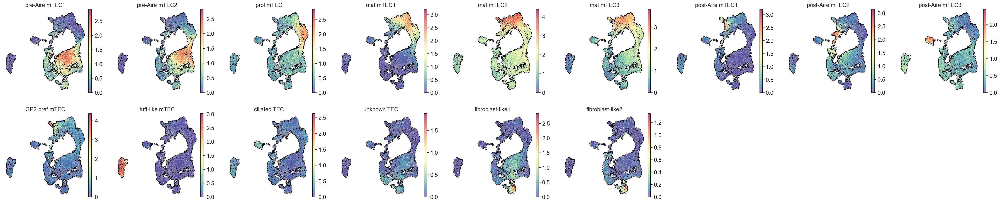

In [68]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    TEC_d0,
    color=['pre-Aire mTEC1', 'pre-Aire mTEC2', 'prol mTEC', 'mat mTEC1', 'mat mTEC2', 'mat mTEC3',
           'post-Aire mTEC1', 'post-Aire mTEC2', 'post-Aire mTEC3', 'GP2-pref mTEC', 'tuft-like mTEC','ciliated TEC', 'unknown TEC',
           'fibroblast-like1', 'fibroblast-like2'],
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=9,
    wspace = 0.2,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = True,
    vmin=0
)

### Baran-Gale et al.

In [69]:
per_cTEC = ['Syngr1', 'Gper1']
mat_cTEC = ['Prss16', 'Cxcl12']
int_TEC = ['Ccl21a', 'Krt5']
prol_TEC = ['Ccna2', 'Pbk']
mat_mTEC = ['Aire', 'Cd52']
postAIRE_mTEC = ['Krt80', 'Spink5']
nTEC = ['Cd177', 'Car8']
tuft = ['Avil', 'Trpm5']
sTEC = ['Sod3', 'Dpt']

In [70]:
sc.tl.score_genes(TEC_d0, gene_list = per_cTEC, score_name='per_cTEC', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = mat_cTEC, score_name='mat_cTEC', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = int_TEC, score_name='int_TEC', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = prol_TEC, score_name='prol_TEC', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = mat_mTEC, score_name='mat_mTEC', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = postAIRE_mTEC, score_name='postAIRE_mTEC', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = nTEC, score_name='nTEC', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = tuft, score_name='tuft', use_raw=False)
sc.tl.score_genes(TEC_d0, gene_list = sTEC, score_name='sTEC', use_raw=False)

computing score 'per_cTEC'
    finished: added
    'per_cTEC', score of gene set (adata.obs).
    100 total control genes are used. (0:00:00)
computing score 'mat_cTEC'
    finished: added
    'mat_cTEC', score of gene set (adata.obs).
    100 total control genes are used. (0:00:00)
computing score 'int_TEC'
    finished: added
    'int_TEC', score of gene set (adata.obs).
    50 total control genes are used. (0:00:00)
computing score 'prol_TEC'
    finished: added
    'prol_TEC', score of gene set (adata.obs).
    49 total control genes are used. (0:00:00)
computing score 'mat_mTEC'
    finished: added
    'mat_mTEC', score of gene set (adata.obs).
    100 total control genes are used. (0:00:00)
computing score 'postAIRE_mTEC'
    finished: added
    'postAIRE_mTEC', score of gene set (adata.obs).
    100 total control genes are used. (0:00:00)
computing score 'nTEC'
    finished: added
    'nTEC', score of gene set (adata.obs).
    100 total control genes are used. (0:00:00)
computin

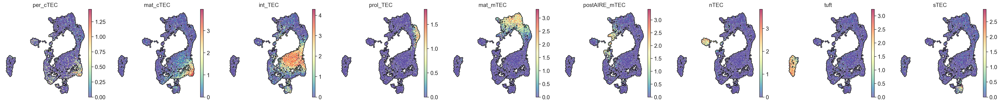

In [71]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    TEC_d0,
    color=['per_cTEC', 'mat_cTEC', 'int_TEC', 'prol_TEC','mat_mTEC', 'postAIRE_mTEC','nTEC', 'tuft', 'sTEC'],
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=9,
    wspace = 0.2,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = True,
    vmin=0
)

### Nusser et al.

In [72]:
early_progenitor_genes = ['Ackr4',	'Adamts10',	'Agrn',	'Aldh2',	'Aldh6a1',	'Amotl1',	'Amotl2',	'Antxr1',	'Apoe',	'Ar',	'Bcam',	'Bcl11a',	'Bcl2',	'Bmp4',	'Btg2',	'Cbx6',	'Ccdc80',	'Cdh11',	'Cldn8',	'Clec11a',	'Clstn1',	'Col18a1',	'Cpne8',	'Cthrc1',	'Cyp1b1',	'Dcn',	'Ddr1',	'Dhrs3',	'Dlk2',	'Dnajc13',	'Dpp6',	'Dpysl2',	'Dsc3',	'Egr1',	'Eid1',	'Fam129a',	'Fam19a5',	'Fkbp9',	'Fmod',	'Fos',	'Fosb',	'Frmd6',	'Fstl1',	'Ogn',	'Gas1',	'Pak3',	'Gbp2',	'Palld',	'Gnaq',	'Pdpn',	'Gpm6b',	'Penk',	'Gprasp1',	'Plxdc2',	'Gstm2',	'Pmp22',	'H2-Dma',	'Prelp',	'Hes6',	'Prrg3',	'Hic1',	'Prss23',	'Hsd17b10',	'Ptprz1',	'Igfbp2',	'Ptrf',	'Igfbp3',	'Pygb',	'Igfbp5',	'Rbp1',	'Igfbp7',	'Rnase4',	'Iigp1',	'Scn1a',	'Il33',	'Serpinf1',	'Irgm1',	'Serpinh1',	'Isl1',	'Shisa2',	'Itm2c',	'Slc2a13',	'Kazald1',	'Sord',	'Lamb1',	'Sparc',	'Laptm4a',	'Spon2',	'Limch1',	'Spry1',	'Ltbp3',	'Tcn2',	'Maged1',	'Tgfbr2',	'Megf6',	'Tgfbr3',	'Meis1',	'Thbd',	'Mgll',	'Thbs1',	'Mgp',	'Timp2',	'Myl9',	'Tinagl1',	'Mylk',	'Tnfrsf19',	'Nbl1',	'Tns1',	'Nell2',	'Tns3',	'Nfia',	'Trim29',	'Nfib',	'Trp63',	'Nfix',	'Tspan9',	'Nr2f1',	'Twsg1',	'Nr4a1',	'Txnip',	'Nrtn',	'Unc119',	'Ntrk3',	'Vmac',	'Oat',	'Wls',	'Wscd1',	'Xdh',	'Zfp36']
postnatal_progenitor_genes = ['Acta2',	'Apoe',	'Ascl1',	'Boc',	'C1s1',	'C3',	'Cald1',	'Ccl11',	'Ccl21a',	'Clca3a1',	'Col6a1',	'Col6a2',	'Cyr61',	'Ddx60',	'Dpysl3',	'Dst',	'Emp2',	'Fam101b',	'Flna',	'Fst',	'Fzd2',	'Gas1',	'Glul',	'Gpx3',	'Gsn',	'Hpgd',	'Htra1',	'Id1',	'Ifi27l2a',	'Igfbp4',	'Igfbp5',	'Irf7',	'Isg15',	'Itga6',	'Itgb4',	'Krt14',	'Krt5',	'Krt7',	'Lamb3',	'Lars2',	'Lifr',	'Mgp',	'Myl9',	'Nrbp2',	'S1pr3',	'Slc4a11',	'Sox4',	'Stat2',	'Sult5a1',	'Tagln',	'Tgfbi',	'Tpm2',	'Wfikkn2']

In [73]:
sc.tl.score_genes(TEC_d0, early_progenitor_genes, score_name='early progenitor\nsignature', use_raw=False)
sc.tl.score_genes(TEC_d0, postnatal_progenitor_genes, score_name='postnatal progenitor\nsignature', use_raw=False)

computing score 'early progenitor\nsignature'
    finished: added
    'early progenitor\nsignature', score of gene set (adata.obs).
    646 total control genes are used. (0:00:00)
computing score 'postnatal progenitor\nsignature'
    finished: added
    'postnatal progenitor\nsignature', score of gene set (adata.obs).
    449 total control genes are used. (0:00:00)


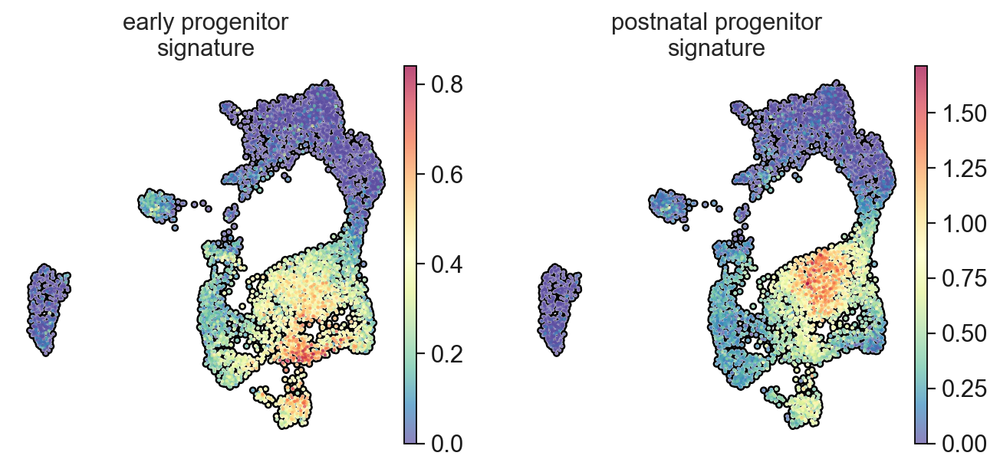

In [74]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    TEC_d0,
    color=['early progenitor\nsignature', 'postnatal progenitor\nsignature'],
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=9,
    wspace = 0.2,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    vmin=0,
    sort_order=True
)

### Michelson et al., 2022

In [75]:
per_cTEC = ['Prss16',	'Ctsl',	'Fabp5',	'Cxcl12',	'Cstb',	'Pltp',	'Psmb11',	'Hes6',	'Pax1',	'Crip3',	'Castor1',	'Nqo1',	'Mdk',	'1810058I24Rik',	'Ndufa11',	'Kcnk2']
adult_cTEC = ['Prss16',	'Tbata',	'Ccl25',	'Ctsl',	'Psmb11',	'Cxcl12',	'Fxyd2',	'Cstb',	'Crip3',	'Ly75',	'Isg20',	'Tmem131l',	'Prxl2b',	'Synm',	'Pax1',	'Cd83',	'Pltp',	'Ndrg3',	'Fn1',	'Gas6',	'Sgpl1']
transit_ampl = ['Hmgb2',	'Hist1h2ap',	'Stmn1',	'H2az1',	'Mki67',	'Top2a',	'Cenpf',	'Ran',	'Cks2']
immature = ['Ccl21a',	'Gm8113',	'Krt14',	'Krt5',	'Tagln',	'Col6a1',	'Fcgbp',	'Lifr',	'Flna',	'Rgs5']
aire = ['Srgn',	'S100a8',	'Ccl5',	'Cd52',	'Ubd',	'S100a9',	'H2-Aa',	'S100a14',	'Cd74',	'Aire',	'Csn2',	'Cxcl9',	'H2-Eb1',	'Cyba',	'Nts',	'H2-Ab1',	'Pyy',	'Ifi30',	'Calcb',	'Hdc',	'Lyz2']
enteropato = ['Saa3',	'Lypd8',	'Spink1',	'Saa1',	'Ttr',	'Reg3b',	'Reg3g',	'Prap1',	'Apoc3',	'Aldob',	'Reg1',	'Pigr',	'Lgals4',	'Clca1',	'Apoa4',	'Tff3',	'S100g',	'Klk1b26',	'2210407C18Rik',	'Cd52',	'Muc13',	'Apoa1',	'AW112010',	'Fabp9']
microfold = ['Ccl20',	'Pglyrp1',	'Serpinb6a',	'Hamp',	'Ccl6',	'Serpinb1a',	'Ccl9',	'Wfdc17',	'Lyz1',	'Rnase1',	'Fabp1',	'Gp2',	'Tnfaip2',	'Msln',	'Cyp2a5',	'Wfdc18',	'Csn2',	'2200002D01Rik',	'Reg3g',	'Ctsh',	'Prg2',	'Gucy1b2',	'Tnfrsf11b',	'Cr2',	'Gjb2',	'Clu',	'Bcl2a1b',	'AW112010',	'H2-M2',	'Fabp5',	'Apoa1',	'Tmsb4x',	'Krt20',	'Spink4',	'Apoa4',	'Nostrin',	'Gpx1',	'Anxa5',	'Spib',	'Plb1',	'Abca13',	'Gm50069',	'Sncg',	'Sox8',	'Bcl2a1a',	'Iapp',	'Bcl2a1d',	'Atp6v1c1',	'Ubd']
neuroendocrine = ['Clca3b',	'Klk1',	'Cd177',	'Resp18',	'Chgb',	'Cacna2d1',	'Chga',	'Ceacam10',	'Rbp4',	'Cd9',	'Iglc3',	'Iapp',	'Ghrl',	'Fam183b',	'Scg2',	'Scg5',	'Itln1',	'Krt7',	'Insm1',	'Fmo3',	'Fmo2',	'Cplx2',	'AW112010']
ptf1a_pancreatic = ['Prss2',	'Clps',	'Spink1',	'Reg1',	'Klk1',	'Ptf1a',	'Chga',	'AW112010',	'Gp2',	'Try5',	'Nupr1',	'Reg3g',	'Fetub',	'Pigr',	'Car8',	'Ceacam10']
muscle = ['Cdkn1c',	'Meg3',	'Mylpf',	'Acta1',	'Myog',	'Myl1',	'Actc1',	'Sln',	'Ckb',	'Ckm',	'Ttn',	'C430049B03Rik',	'Spg21',	'Mymx',	'Ppp1r14b',	'Dlk1',	'Neb',	'5430431A17Rik',	'Hes6',	'Rian',	'Tnnc2',	'Des',	'Lsm6',	'Arl6ip5',	'Rbm24']
tuft1 = ['Fyb',	'Dclk1',	'Ptpn18',	'Atp1a2',	'Sh2d6',	'Plcb2',	'Nrgn',	'Trpm5',	'Agt',	'Ahnak2',	'Ly6g6f']
tuft2 = ['Gnat3',	'Gnb3',	'Plac8',	'Gng13',	'Lrmp',	'Rgs13',	'Cited2',	'Krt19',	'Ethe1',	'Fxyd6',	'Cystm1']
goblet = ['Ltf',	'Wfdc2',	'Gsto1',	'Ecm1',	'Bpifa1',	'Anxa1',	'Lcn2',	'Nupr1',	'Trf',	'Gsta4',	'Serpinb11',	'Pigr',	'Ly6d',	'Scgb3a2',	'Spink5',	'Ifitm1',	'Cxcl17',	'Serpinb2',	'Psca',	'Ly6a',	'Krt6a',	'Krt6b',	'Prss27',	'Scgb3a1',	'Hspb1',	'S100a6',	'Sftpd',	'Cxcl5',	'Cyp2f2',	'Sat1',	'Fxyd3',	'Cbr2',	'Clu',	'Aqp4',	'Cnfn',	'Rptn',	'Plet1',	'Lgals3']
ionocyte = ['Slc12a2',	'Atp6v1g3',	'Iapp',	'Slc4a11',	'S100a6',	'Ascl3',	'Foxi1',	'Gm47662',	'Pam',	'Serpinb9',	'Rnase4',	'Umod',	'Tfcp2l1',	'Wfdc2',	'Cftr',	'Atp6v1b1',	'Atp1a1',	'Cxcl17',	'Nupr1',	'Cd24a']
ciliated = ['Tppp3',	'Ccdc153',	'Dynlrb2',	'Fam183b',	'Ly6c1',	'Tubb4b',	'Tmem212',	'Lcn2',	'Meig1',	'Lrrc23',	'S100a6',	'Elof1',	'Riiad1',	'1110017D15Rik',	'Foxj1',	'Hsp90aa1',	'Rsph1',	'Mt1',	'Nudc',	'Ifitm1',	'AU040972',	'Chchd10',	'Vpreb3',	'1700016K19Rik',	'Tmem107',	'Mlf1',	'Nudt4',	'Hdc',	'Cfap298',	'Lrrc51',	'Hp',	'Ccdc39',	'Ly6a',	'Cacna1s',	'Tm4sf1',	'Pifo',	'Gm867',	'Fam166c',	'Tekt1',	'Cfap126',	'Gm19935',	'Dnah12',	'Wfdc2',	'BC051019',	'4833427G06Rik',	'Arhgdig',	'Crip1',	'Cep83',	'Sntn',	'Plet1',	'Ccdc34',	'Ccdc17',	'Cfap44',	'Spef2',	'Ccdc30',	'Crip2',	'3300002A11Rik',	'Spaca9',	'Cdkn1c',	'Ruvbl2',	'Enkur',	'Bst2',	'Nme5',	'Spag17',	'Ccdc78',	'Dnah6',	'Ccdc189',	'Lrriq1',	'Cp',	'Nme9']
lung_basal = ['Bpifa1',	'Wfdc2',	'Spink5',	'S100g',	'Rptn',	'Upk3a',	'Reg3g',	'Spink1',	'Gsta4',	'Tff1',	'Cyp2a5',	'Nupr1',	'Ly6d',	'Cyp2f2',	'Gm2a',	'Dapl1',	'Serpinb11',	'Serpinb2',	'Oit1',	'Scgb1a1',	'Gm94']
skin_basal = ['Krt10',	'Lgals7',	'Krtdap',	'Defb6',	'Gm94',	'Dapl1',	'Krt1',	'Dmkn',	'Calm4',	'Krt77',	'Krt16',	'Ly6d',	'Tmem45a',	'Fam25c',	'Ly6g6c',	'Calml3',	'Spink5',	'Lypd3',	'Gltp',	'Gsta4',	'Krt79',	'Sfn',	'Sbsn',	'Wfdc21',	'Skint3',	'Krt17',	'Perp',	'Sprr1a',	'Cst6',	'Slurp1',	'Serpinb2',	'Pdzk1ip1',	'Ear1',	'Flg',	'Hspb1',	'Clca3a2']
skin_kerat = ['Cst6',	'Flg',	'Calm4',	'Krtdap',	'Asprv1',	'Crct1',	'Lor',	'Klk7',	'Sprr1a',	'Dmkn',	'Cnfn',	'Sbsn',	'2310046K23Rik',	'Spink5',	'Krt16',	'Fam25c',	'Wfdc21',	'Hrnr',	'Dapl1',	'Il1f6',	'Gm94',	'Krt77',	'Psapl1',	'Chil1',	'Defb6',	'Gan',	'Calml3',	'Krt10',	'Ly6g6c',	'Scgb1a1',	'Acpp',	'Nccrp1',	'Rptn',	'S100a9',	'Krt23',	'Klk6',	'Krt79',	'Elovl4',	'Pdzk1ip1',	'Spink12',	'Slurp1',	'Glrx',	'Tmem45a',	'Nupr1',	'Il1f5',	'Ly6d',	'Krt17',	'Cdsn',	'Hspb1',	'Klk13',	'Ivl',	'Lypd5',	'Sprr2d',	'Lypd3',	'Clic3',	'Ide',	'Cebpb',	'Csta1',	'Tacstd2',	'Flg2',	'Ctsd',	'Endou',	'Krt80',	'Ybx3',	'Cyp2b19',	'Hal',	'Psors1c2',	'Perp',	'Cysrt1',	'Cdkn1a',	'Prdx5',	'Efna3',	'Orm1']

In [77]:
sc.tl.score_genes(TEC_d0, per_cTEC, score_name='per_cTEC', use_raw=False)
sc.tl.score_genes(TEC_d0, adult_cTEC, score_name='adult_cTEC', use_raw=False)
sc.tl.score_genes(TEC_d0, transit_ampl, score_name='transit_ampl', use_raw=False)
sc.tl.score_genes(TEC_d0, immature, score_name='immature', use_raw=False)
sc.tl.score_genes(TEC_d0, aire, score_name='aire', use_raw=False)
sc.tl.score_genes(TEC_d0, enteropato, score_name='enteropato', use_raw=False)
sc.tl.score_genes(TEC_d0, microfold, score_name='microfold', use_raw=False)
sc.tl.score_genes(TEC_d0, neuroendocrine, score_name='neuroendocrine', use_raw=False)
sc.tl.score_genes(TEC_d0, ptf1a_pancreatic, score_name='ptf1a_pancreatic', use_raw=False)
sc.tl.score_genes(TEC_d0, muscle, score_name='muscle', use_raw=False)
sc.tl.score_genes(TEC_d0, tuft1, score_name='tuft1', use_raw=False)
sc.tl.score_genes(TEC_d0, tuft2, score_name='tuft2', use_raw=False)
sc.tl.score_genes(TEC_d0, goblet, score_name='goblet', use_raw=False)
sc.tl.score_genes(TEC_d0, ionocyte, score_name='ionocyte', use_raw=False)
sc.tl.score_genes(TEC_d0, ciliated, score_name='ciliated', use_raw=False)
sc.tl.score_genes(TEC_d0, lung_basal, score_name='lung_basal', use_raw=False)
sc.tl.score_genes(TEC_d0, skin_basal, score_name='skin_basal', use_raw=False)
sc.tl.score_genes(TEC_d0, skin_kerat, score_name='skin_kerat', use_raw=False)

computing score 'per_cTEC'
    finished: added
    'per_cTEC', score of gene set (adata.obs).
    299 total control genes are used. (0:00:00)
computing score 'adult_cTEC'
    finished: added
    'adult_cTEC', score of gene set (adata.obs).
    398 total control genes are used. (0:00:00)
computing score 'transit_ampl'
    finished: added
    'transit_ampl', score of gene set (adata.obs).
    350 total control genes are used. (0:00:00)
computing score 'immature'
    finished: added
    'immature', score of gene set (adata.obs).
    198 total control genes are used. (0:00:00)
computing score 'aire'
    finished: added
    'aire', score of gene set (adata.obs).
    356 total control genes are used. (0:00:00)
computing score 'enteropato'
    finished: added
    'enteropato', score of gene set (adata.obs).
    550 total control genes are used. (0:00:00)
computing score 'microfold'
    finished: added
    'microfold', score of gene set (adata.obs).
    603 total control genes are used. (0:00:

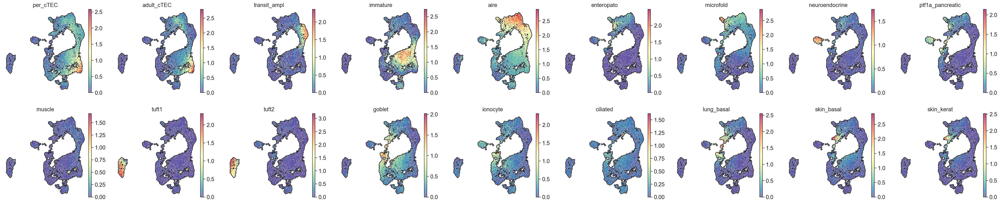

In [78]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    TEC_d0, 
    color=['per_cTEC', 'adult_cTEC', 'transit_ampl', 'immature', 'aire', 'enteropato', 'microfold',
           'neuroendocrine', 'ptf1a_pancreatic', 'muscle', 'tuft1', 'tuft2', 'goblet', 'ionocyte', 'ciliated', 
          'lung_basal', 'skin_basal', 'skin_kerat'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=9,
    wspace = 0.2,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = True,
    vmin=0
)

### TECs clustering and annotation

In [79]:
for resolution_parameter in [1.1, 1.2, 1.3, 1.4, 1.5, 1.6, 1.7, 1.8, 1.9, 2.0]:
    sc.tl.leiden(TEC_d0, resolution=resolution_parameter, random_state=42, 
                        key_added='leiden_'+str(resolution_parameter))

running Leiden clustering
    finished: found 16 clusters and added
    'leiden_1.1', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 18 clusters and added
    'leiden_1.2', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 18 clusters and added
    'leiden_1.3', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 18 clusters and added
    'leiden_1.4', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 19 clusters and added
    'leiden_1.5', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 21 clusters and added
    'leiden_1.6', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 21 clusters and added
    'leiden_1.7', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clust

In [ ]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)
sc.pl.umap(
    TEC_d0, 
    color=['leiden_1.1', 'leiden_1.2', 'leiden_1.3', 'leiden_1.4', 'leiden_1.5', 
           'leiden_1.6', 'leiden_1.7', 'leiden_1.8','leiden_1.9', 'leiden_2.0'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.3,
    outline_width=[0.6, 0.05],
    frameon=False,
    add_outline=True,
    sort_order = False
)

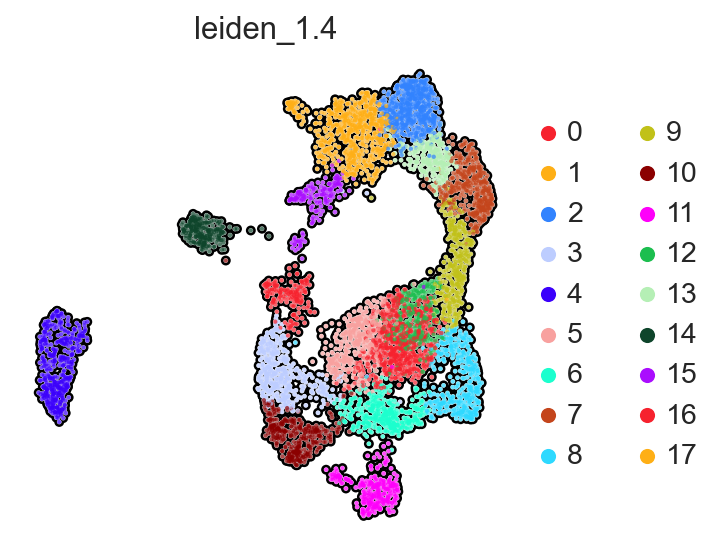

In [81]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)
sc.pl.umap(
    TEC_d0, 
    color=['leiden_1.4'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=6,
    size=15,
    wspace = 0.2,
    outline_width=[0.6, 0.05],
    frameon=False,
    add_outline=True,
    sort_order = False
)

In [82]:
TEC_d0.obs['cell_type_subset'] = ['11:aaTEC2' if (x=='11') else '10:aaTEC1' if (x=='3' or x=='10') else '12:early Pr' if x=='6' else
                                 '12:cTEC' if (x=='8') else '13:mTEC1' if ( x=='5' or x=='9' or x=='12' or x=='0') else 
                                 '14:mTEC-prol' if x=='7' else '15:mTEC2' if (x=='1' or x=='2' or x=='13') else
                                 '16:mimetic(basal)' if ( x=='15') else '17:mimetic(tuft)' if x=='4' else '18:mimetic(neuroendo)' if x=='14' else
                                 '19:mimetic(goblet)' if x=='16' else '20:mimetic(microfold)' if x=='17' else 'ERROR' for x in TEC_d0.obs['leiden_1.4']] 

In [83]:
TEC_d0.uns['cell_type_subset_colors'] = [ '#2ED9FF', '#c1c119',  '#8b0000','#3B00FB', '#FE00FA', "#F8A19F", '#1CBE4F','#B5EFB5', '#BEFFF7' ,'#FEAF16', '#325A9B', '#C075A6']

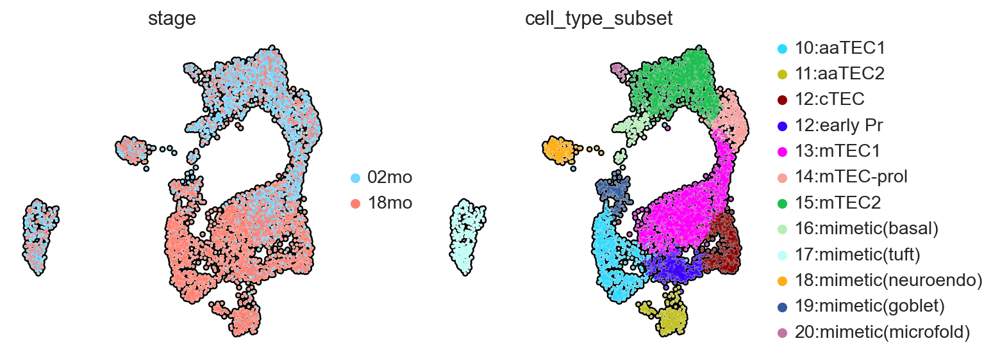

In [84]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    TEC_d0, 
    color=['stage', 'cell_type_subset'], 
    ncols=6,
    use_raw=False,
    outline_width=[0.6, 0.05],
    frameon=False,
    size=15,
    cmap='Spectral_r',
    wspace = 0.2,
    add_outline=True
)

### DGE analysis within the TEC compartment

In [ ]:
sc.tl.rank_genes_groups(TEC_d0, 'cell_type_subset', method='wilcoxon', use_raw=False)

In [ ]:
writer = pd.ExcelWriter('TEC_d0_wilcox.xlsx', engine='xlsxwriter')

# top 5 differentially expressed genes for each cell type. Change number in brackets to get a more extended gene list
result = TEC_d0.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'scores', 'logfoldchanges', 'pvals_adj']}).to_excel(writer)
writer.save()

## Transfer annotation

In [85]:
annotated_subsets = pd.concat([EC_d0.obs['cell_type_subset'], FB_d0.obs['cell_type_subset'],  TEC_d0.obs['cell_type_subset'], adata_d0[(adata_d0.obs['cell_type']=='6:MEC') | (adata_d0.obs['cell_type']=='7:vSMC/PC') | (adata_d0.obs['cell_type']=='8:nmSC')].obs['cell_type']])

In [86]:
adata_d0.obs['cell_type_subset']=''

In [87]:
adata_d0.obs['cell_type_subset'][adata_d0.obs.index.isin(annotated_subsets.index) == True] = annotated_subsets

/var/folders/yr/0_lgn5q107n7hthkgy5vt7p40000gq/T/ipykernel_17728/2123713985.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_d0.obs['cell_type_subset'][adata_d0.obs.index.isin(annotated_subsets.index) == True] = annotated_subsets


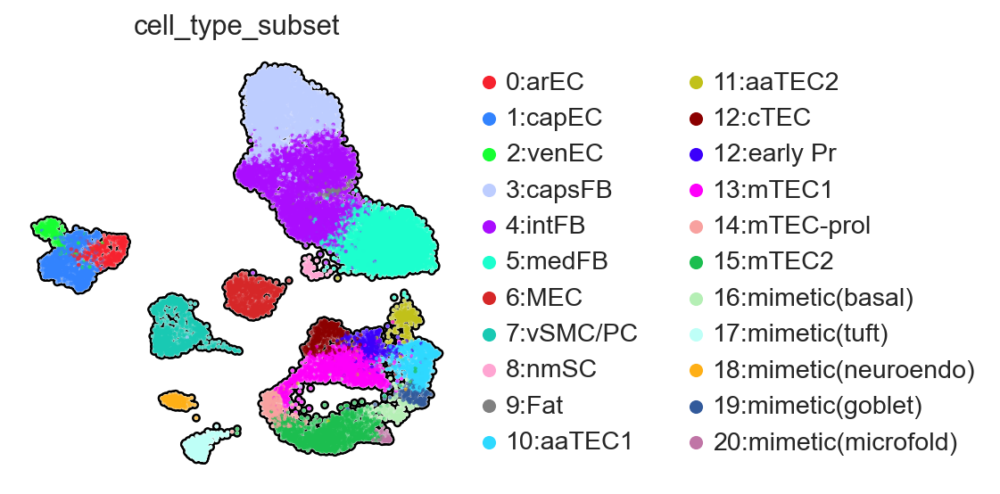

In [88]:
subset_palette = ['#F6222E', '#3283FE', '#16FF32',  '#BDCDFF', '#AA0DFE','#1CFFCE', '#d62728', '#19c9b3','#FFA5D2',   'grey', '#2ED9FF', '#c1c119', '#8b0000', '#3B00FB', '#FE00FA', "#F8A19F", '#1CBE4F','#B5EFB5', '#BEFFF7','#FEAF16', '#325A9B', '#C075A6']

sc.pl.umap(adata_d0, color=['cell_type_subset'], 
                     color_map='Spectral_r',
                     palette=subset_palette,
                     use_raw=False, 
                     ncols=4, 
                     wspace = 0.3,
                     outline_width=[0.6, 0.05], 
                     size=15,  
                     frameon=False, 
                     add_outline=True, 
                     sort_order = False
)

### Frequencies

In [89]:
TEC_d0 = adata_d0[(adata_d0.obs['cell_type_subset']=='12:cTEC') |
                  (adata_d0.obs['cell_type_subset']=='14:mTEC-prol') |
                  (adata_d0.obs['cell_type_subset']=='15:mTEC2') |
                  (adata_d0.obs['cell_type_subset']=='16:mimetic(basal)') |
                  (adata_d0.obs['cell_type_subset']=='17:mimetic(tuft)') |
                  (adata_d0.obs['cell_type_subset']=='18:mimetic(neuroendo)') |
                  (adata_d0.obs['cell_type_subset']=='19:mimetic(goblet)') |
                  (adata_d0.obs['cell_type_subset']=='20:mimetic(microfold)') | 
                  (adata_d0.obs['cell_type_subset']=='10:aaTEC1') |
                  (adata_d0.obs['cell_type_subset']=='11:aaTEC2') |
                  (adata_d0.obs['cell_type_subset']=='12:early Pr') |
                  (adata_d0.obs['cell_type_subset']=='13:mTEC1')]

In [90]:
crosstb_TEC = pd.crosstab(TEC_d0.obs['stage'], TEC_d0.obs['cell_type_subset'], normalize='index')
diffcrosstb_TEC = ((crosstb_TEC.loc["18mo"] - crosstb_TEC.loc["02mo"]) / (crosstb_TEC.loc["18mo"] + crosstb_TEC.loc["02mo"]))*100
crosstb_TEC 

cell_type_subset,10:aaTEC1,11:aaTEC2,12:cTEC,12:early Pr,13:mTEC1,14:mTEC-prol,15:mTEC2,16:mimetic(basal),17:mimetic(tuft),18:mimetic(neuroendo),19:mimetic(goblet),20:mimetic(microfold)
stage,,,,,,,,,,,,
02mo,0.003775,0.007550,0.020134,0.015940,0.242869,0.101510,0.389262,0.051594,0.101930,0.036493,0.017198,0.011745
18mo,0.191770,0.067792,0.086257,0.094434,0.279082,0.037721,0.120549,0.010551,0.042733,0.032445,0.031654,0.005012


In [91]:
crosstb_TEC = pd.crosstab(TEC_d0.obs['stage'], TEC_d0.obs['cell_type_subset'], normalize='index')
diffcrosstb_TEC = ((crosstb_TEC.loc["18mo"] - crosstb_TEC.loc["02mo"]) / (crosstb_TEC.loc["18mo"] + crosstb_TEC.loc["02mo"]))*100
crosstb_TEC 

cell_type_subset,10:aaTEC1,11:aaTEC2,12:cTEC,12:early Pr,13:mTEC1,14:mTEC-prol,15:mTEC2,16:mimetic(basal),17:mimetic(tuft),18:mimetic(neuroendo),19:mimetic(goblet),20:mimetic(microfold)
stage,,,,,,,,,,,,
02mo,0.003775,0.007550,0.020134,0.015940,0.242869,0.101510,0.389262,0.051594,0.101930,0.036493,0.017198,0.011745
18mo,0.191770,0.067792,0.086257,0.094434,0.279082,0.037721,0.120549,0.010551,0.042733,0.032445,0.031654,0.005012


In [92]:
FB_d0_nofat = adata_d0[(adata_d0.obs['cell_type_subset']=='3:capsFB') |
                  (adata_d0.obs['cell_type_subset']=='4:intFB') |
                  (adata_d0.obs['cell_type_subset']=='5:medFB')]

In [93]:
crosstb_FB = pd.crosstab(FB_d0_nofat.obs['stage'], FB_d0_nofat.obs['cell_type_subset'], normalize='index')
diffcrosstb_FB = ((crosstb_FB.loc["18mo"] - crosstb_FB.loc["02mo"]) / (crosstb_FB.loc["18mo"] + crosstb_FB.loc["02mo"]))*100

In [94]:
EC_d0 = adata_d0[(adata_d0.obs['cell_type_subset']=='0:arEC') |
                 (adata_d0.obs['cell_type_subset']=='1:capEC') |
                 (adata_d0.obs['cell_type_subset']=='2:venEC')]

In [95]:
crosstb_EC = pd.crosstab(EC_d0.obs['stage'], EC_d0.obs['cell_type_subset'],  normalize='index')
diffcrosstb_EC = ((crosstb_EC.loc["18mo"] - crosstb_EC.loc["02mo"]) / (crosstb_EC.loc["18mo"] + crosstb_EC.loc["02mo"]))*100

In [96]:
other_d0 = adata_d0[(adata_d0.obs['cell_type_subset']=='6:MEC') |
                 (adata_d0.obs['cell_type_subset']=='7:vSMC/PC') | 
                 (adata_d0.obs['cell_type_subset']=='9:Fat') |
                 (adata_d0.obs['cell_type_subset']=='8:nmSC')]

In [97]:
crosstb_other = pd.crosstab(other_d0.obs['stage'], other_d0.obs['cell_type_subset'],  normalize='index')
crosstb_other

cell_type_subset,6:MEC,7:vSMC/PC,8:nmSC,9:Fat
stage,,,,
02mo,0.331950,0.556017,0.051867,0.060166
18mo,0.435739,0.489347,0.039175,0.035739


In [98]:
crosstb_other = pd.crosstab(other_d0.obs['stage'], other_d0.obs['cell_type_subset'],  normalize='index')
diffcrosstb_other = ((crosstb_other.loc["18mo"] - crosstb_other.loc["02mo"]) / (crosstb_other.loc["18mo"] + crosstb_other.loc["02mo"]))*100

In [99]:
diffcrosstb = pd.concat([diffcrosstb_EC, diffcrosstb_FB,  diffcrosstb_TEC, diffcrosstb_other])

In [100]:
diffcrosstb

cell_type_subset
0:arEC                  -10.276902
1:capEC                   8.038372
2:venEC                 -22.950359
3:capsFB                -26.807210
4:intFB                  -9.516664
5:medFB                  29.841551
10:aaTEC1                96.138827
11:aaTEC2                79.957293
12:cTEC                  62.150559
12:early Pr              71.117059
13:mTEC1                  6.937988
14:mTEC-prol            -45.815340
15:mTEC2                -52.708432
16:mimetic(basal)       -66.043091
17:mimetic(tuft)        -40.920637
18:mimetic(neuroendo)    -5.871930
19:mimetic(goblet)       29.591335
20:mimetic(microfold)   -40.181189
6:MEC                    13.519618
7:vSMC/PC                -6.377639
8:nmSC                  -13.940704
9:Fat                   -25.470197
dtype: float64

In [ ]:
path_to_h5ad = '../output/anndata_io/Fig1pt1_annotated.h5ad'

In [ ]:
#adata_d0.write(path_to_h5ad)

In [ ]:
adata_d0 = sc.read_h5ad(path_to_h5ad)
adata_d0.uns['log1p']["base"] = None